# Import & Prepare Data

In [ ]:
# import libraries
import os
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
from scipy.stats import norm
from datetime import datetime
import matplotlib.pyplot as plt

# import csv
pwd = os.getcwd()
filepath = pwd + "/Crime_Data_from_2020_to_Present.csv"
df = pd.read_csv(filepath)

In [ ]:
# drop irrelevant columns
df = df.drop(["DR_NO", "AREA", "Rpt Dist No", "Part 1-2", "Crm Cd", "Cross Street", 
        "Mocodes", "Premis Cd", "Weapon Used Cd", "Status", "Status Desc", 
        "Crm Cd 1", "Crm Cd 2", "Crm Cd 3", "Crm Cd 4"], axis=1)

In [ ]:
# rename columns
df = df.rename(columns={"Date Rptd": "Date Reported", "DATE OCC": "Date Occured", 
                    "TIME OCC": "Time Occured", "AREA NAME": "Area Name", 
                    "Crm Cd Desc": "Crime Description", "Vict Age": "Victim Age",
                    "Vict Sex": "Victim Sex", "Vict Descent": "Victim Descent", 
                    "Premis Desc": "Premis Description", "Weapon Desc": "Weapon Description", 
                    "LOCATION": "Location", "LAT": "Latitude", "LON": "Longitude"})

In [ ]:
# drop duplicates 
df = df.drop_duplicates()

In [ ]:
# fill NaN
df = df.fillna("Not Available")

# fill Victim Age "0" with Unknown
df["Victim Age"] = df['Victim Age'].replace(0, 'Not Available')

In [ ]:
# disable SettingWithCopyWarning
pd.options.mode.chained_assignment = None

# convert first 3 columns to datetime
df[["Date Reported", "Date Occured"]] = df[["Date Reported", "Date Occured"]].apply(pd.to_datetime)

In [ ]:
# relabel Victim Descent column strings
df["Victim Descent"] = df['Victim Descent'].str.replace('A', 'Other Asian')
df["Victim Descent"] = df['Victim Descent'].str.replace('B', 'Black')
df["Victim Descent"] = df['Victim Descent'].str.replace('C', 'Chinese')
df["Victim Descent"] = df['Victim Descent'].str.replace('D', 'Cambodian')
df["Victim Descent"] = df['Victim Descent'].str.replace('F', 'Filipino')
df["Victim Descent"] = df['Victim Descent'].str.replace('G', 'Guamanian')
df["Victim Descent"] = df['Victim Descent'].str.replace('H', 'Hispanic/Latin/Mexican')
df["Victim Descent"] = df['Victim Descent'].str.replace('I', 'American Indian/Alaskan Native')
df["Victim Descent"] = df['Victim Descent'].str.replace('J', 'Japanese')
df["Victim Descent"] = df['Victim Descent'].str.replace('K', 'Korean')
df["Victim Descent"] = df['Victim Descent'].str.replace('L', 'Laotian')
df["Victim Descent"] = df['Victim Descent'].str.replace('O', 'Other')
df["Victim Descent"] = df['Victim Descent'].str.replace('P', 'Pacific Islander')
df["Victim Descent"] = df['Victim Descent'].str.replace('S', 'Samoan')
df["Victim Descent"] = df['Victim Descent'].str.replace('U', 'Hawaiian')
df["Victim Descent"] = df['Victim Descent'].str.replace('V', 'Vietnamese')
df["Victim Descent"] = df['Victim Descent'].str.replace('W', 'White')
df["Victim Descent"] = df['Victim Descent'].str.replace('Z', 'Asian Indian')
df["Victim Descent"] = df['Victim Descent'].str.replace('X', 'Unknown')

# relabel Victim Sex coulmn strings 
df["Victim Sex"] = df['Victim Sex'].str.replace('M', 'Male')
df["Victim Sex"] = df['Victim Sex'].str.replace('F', 'Female')
df["Victim Sex"] = df['Victim Sex'].str.replace('X', 'Other')
df["Victim Sex"] = df['Victim Sex'].str.replace('H', 'Other')

In [ ]:
# sort dataframe by Date Occured
df = df.sort_values(by="Date Occured")

# Based on the historical data from 2020-present, What day and times had the most and least crime incidents in the city of LA?

In [ ]:
# bin "Time Occured" column
bins = [0, 100, 200, 300, 400, 500, 600, 
        700, 800, 900, 1000, 1100, 1200,
        1300, 1400, 1500, 1600, 1700, 1800,
        1900, 2000, 2100, 2200, 2300, 2400]
df['Hour (Military Time)'] = pd.cut(df['Time Occured'], bins)

In [ ]:
# create a seperate column with weekday 
df["Weekday"] = df['Date Occured'].dt.day_name()

In [ ]:
# groub by weekday and hour
df.groupby("Hour (Military Time)").Weekday.value_counts()

Hour (Military Time)  Weekday  
(0, 100]              Sunday       4614
                      Saturday     4113
                      Monday       3884
                      Friday       3650
                      Wednesday    3646
                                   ... 
(2300, 2400]          Sunday       1963
                      Wednesday    1671
                      Thursday     1633
                      Tuesday      1611
                      Monday       1591
Name: Weekday, Length: 168, dtype: int64

In [ ]:
# unstack data
unstack_data = (df.groupby("Hour (Military Time)")
.Weekday
.value_counts()
.unstack()
.fillna(0)
)

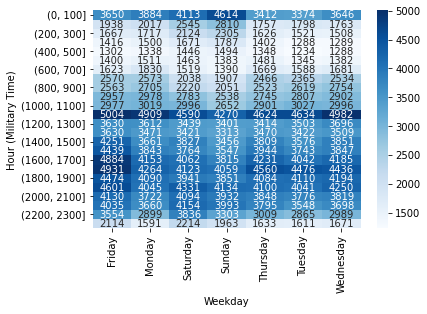

In [ ]:
# display heatmap
sns.heatmap(unstack_data, cmap="Blues", annot=True, fmt=".0f");

Dangerous Weekday: Friday 
Dangerous Hour: 11AM-12PM
Most Dangerous Hour and Weekday: Friday from 11am-12pm

Least Dangerous Weekday: Tuesday
Least Dangerous Hour: 4am-5am
Least Dangerous Hour and Weekday: Tuesday 4am-5am

Looking at the heatmap, we see that 11am-12pm consistently had the highest crime incidents throughout the week from 2020-present. Other notable times include 2pm-8pm on Friday and 12am on Sunday. This makes sense because Friday afternoons and late Saturday nights/early sunday mornings are times of leisure and everybody is out looking for a good time or a bad time...    

# Based on the historical data, What gender had the highest and lowest number of crime victims in 2020-present in the city of LA?

In [ ]:
# display graph
sex_fig = px.histogram(df, x="Victim Sex",
             color='Victim Sex').update_xaxes(categoryorder='total descending')
sex_fig.show()

Highest: Male
Lowest: Female

# Based on the historical data, What descent had the highest and lowest number of crime victims in 2020-present in the city of LA?

In [ ]:
# display graph
descent_fig = px.histogram(df, x="Victim Descent",
             color='Victim Descent').update_xaxes(categoryorder='total descending')
descent_fig.show()

Highest: Hispanic (Also has the highest population in the city of LA based on Census data), White, Black
Lowest: Cambodian, Laotian, Samoan (Also has the lowest population in the city of LA bassed on Census data)

# Based on the historical data, Which crimes were the most and least common in 2020-present in the city of LA?

In [ ]:
# display graph
crime_fig = px.histogram(df, x="Crime Description",
             color='Crime Description').update_xaxes(categoryorder='total descending')
crime_fig.show()

Most common crime: 1. Stolen vehicles, 2. Battery - Simple Assault, & 3. burglary from vehicle 
Least Common crime: 1. Grand Theft / Auto Repair, 2. Failure to Disperse, 3. Telephone Property Damage

# Based on the historical data, What age had the highest, lowest, and the average number of crime victims in 2020-present in the city of LA?

In [ ]:
# drop non floating point values from column
df = df[df["Victim Age"] != "Not Available"]

# drop outlier values 
df.drop(df[df['Victim Age'] >= 100].index, inplace = True)
df.drop(df[df['Victim Age'] < 2].index, inplace = True)

In [ ]:
# calculate the mean, median, mode, and standard deviation
print("Mean: ", df["Victim Age"].mean())
print("Median: ", df["Victim Age"].median())
print("Mode: ", df["Victim Age"].mode())
print("Std: ", df["Victim Age"].std())

Mean:  39.62896187236583
Median:  37.0
Mode:  0    30
dtype: object
Std:  15.516617488788553


In [ ]:
# count the most and least frequent values in column
s = df["Victim Age"].value_counts()

# print most frequent value in column 
highest = s.index[0]
print(highest)

# print least frequent value in column 
lowest = s.index[-1]
print(lowest)

30
97


In [ ]:
# display interactive plotly graph
age_fig = px.histogram(df, x="Victim Age")
age_fig.show()

Highest (Mode): Age 30 

1.   List item
2.   List item


Lowest: Age 97
Mean: Age 39
Median: Age 37

# Based on the historical data, Which areas have the highest and lowest crime incidents in the city of LA?

In [ ]:
fig = px.scatter_geo(df, lat="Latitude", lon="Longitude", hover_name="Location", hover_data=["Date Occured", "Premis Description", 
                            "Crime Description"], color_discrete_sequence = ["blue"], height=400)
fig.show()

TBA

# Based on the historical data, What incidents have happened at x location?

In [ ]:
# create interactive map that maps past crime with location, date, time, and crime
int_fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Location", hover_data=["Date Occured", "Premis Description", 
                            "Crime Description"], color_discrete_sequence = ["blue"], zoom=7, height=400)

# display map
int_fig.update_layout(mapbox_style ="open-street-map")
int_fig.update_layout(margin ={"r":0,"t":0,"l":0,"b":0})
int_fig.show()

# What is the probability of being a crime victim in the next 2 1/2 years?

In [ ]:
# calculate rough probability of being a crime victim in the next 2 1/2 years 
la_city_population = 3849297 # from 2020 census data 
la_city_crime = 512448 # length of dataset rows
prob = la_city_crime / la_city_population
round(prob, 2)

0.13

There is a 13% rough probability that you will be a crime victim in the next 2 1/2 years

Probability of being a crime victim in the next 2 1/2 years is 13% (13 out of 100) (87:13)

Probability of not being a crime victim in the next 2 1/2 years is 87% (87 out of 100) (87:13)

# What is the probability that the next crime victim is a male?

In [ ]:
# drop "other" values that are not male or female
df_descent = df[df["Victim Sex"] != "Not Available"]
df_descent = df[df["Victim Sex"] != "Other"]

# calculate rough probability of being a crime victim in the next 2 1/2 years 
male = 215200 # from 2020 census data 
sample = len(df) # length of dataset rows
prob = male / sample
round(prob, 2)

0.55

There is an approximate 55% probability that the next crime victim is a male

There is an approximate 45% probability that the next crime victim is a female 

# What is the probability that the next crime victim is Hispanic?

In [ ]:
# calculate rough probability of being a crime victim in the next 2 1/2 years 
hispanic = 157365 # from 2020 census data 
sample = 512448 # length of dataset rows
prob = hispanic / sample
round(prob, 2)

0.31

There is an approximate 31% probability that the next crime victim is Hispanic

# What is the probability that the next crime victim is between the ages of x?

In [ ]:
# calculate victim age mean, median, mode, and standard deviation
print("Mean: ", df["Victim Age"].mean())
print("Median: ", df["Victim Age"].median())
print("Mode: ", df["Victim Age"].mode())
print("Std: ", df["Victim Age"].std())

Mean:  39.62896187236583
Median:  37.0
Mode:  0    30
dtype: object
Std:  15.516617488788553


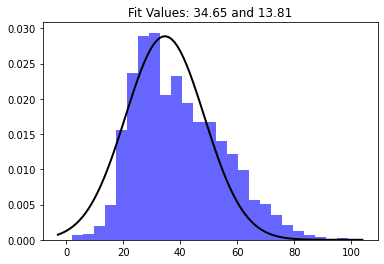

In [ ]:
# input mean, standard deviation, and max value
data = np.random.normal(35, 15, 120)
  
# fit a normal distribution to the data:
# mean and standard deviation
mu, std = norm.fit(data) 
  
# plot the histogram
plt.hist(df["Victim Age"], bins=25, density=True, alpha=0.6, color='b')
  
# plot
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
  
plt.plot(x, p, 'k', linewidth=2)
title = "Fit Values: {:.2f} and {:.2f}".format(mu, std)
plt.title(title)
  
plt.show()

1. There is an approximate 68% probability that the next crime victim is between the ages of 24-56
2. There is an approximate 95% probability that the next crime victim is between the ages of 8-72
3. There is an approximate 99% probability that the next crime victim is between the ages of 0-88